In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

In [2]:
df = pd.read_csv('./loan_data.csv')

In [3]:
df.head()

,credit.policy,purpose,int.rate,installment,log.annual.inc,dti,fico,days.with.cr.line,revol.bal,revol.util,inq.last.6mths,delinq.2yrs,pub.rec,not.fully.paid
0,1,debt_consolidation,0.1189,829.10,11.350407,19.48,737,5639.958333,28854,52.1,0,0,0,0
1,1,credit_card,0.1071,228.22,11.082143,14.29,707,2760.000000,33623,76.7,0,0,0,0
2,1,debt_consolidation,0.1357,366.86,10.373491,11.63,682,4710.000000,3511,25.6,1,0,0,0
3,1,debt_consolidation,0.1008,162.34,11.350407,8.10,712,2699.958333,33667,73.2,1,0,0,0
4,1,credit_card,0.1426,102.92,11.299732,14.97,667,4066.000000,4740,39.5,0,1,0,0


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9578 entries, 0 to 9577
Data columns (total 14 columns):
credit.policy        9578 non-null int64
purpose              9578 non-null object
int.rate             9578 non-null float64
installment          9578 non-null float64
log.annual.inc       9578 non-null float64
dti                  9578 non-null float64
fico                 9578 non-null int64
days.with.cr.line    9578 non-null float64
revol.bal            9578 non-null int64
revol.util           9578 non-null float64
inq.last.6mths       9578 non-null int64
delinq.2yrs          9578 non-null int64
pub.rec              9578 non-null int64
not.fully.paid       9578 non-null int64
dtypes: float64(6), int64(7), object(1)
memory usage: 1.0+ MB


In [5]:
df.describe()

,credit.policy,int.rate,installment,log.annual.inc,dti,fico,days.with.cr.line,revol.bal,revol.util,inq.last.6mths,delinq.2yrs,pub.rec,not.fully.paid
count,9578.000000,9578.000000,9578.000000,9578.000000,9578.000000,9578.000000,9578.000000,9.578000e+03,9578.000000,9578.000000,9578.000000,9578.000000,9578.000000
mean,0.804970,0.122640,319.089413,10.932117,12.606679,710.846314,4560.767197,1.691396e+04,46.799236,1.577469,0.163708,0.062122,0.160054
std,0.396245,0.026847,207.071301,0.614813,6.883970,37.970537,2496.930377,3.375619e+04,29.014417,2.200245,0.546215,0.262126,0.366676
min,0.000000,0.060000,15.670000,7.547502,0.000000,612.000000,178.958333,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,0.103900,163.770000,10.558414,7.212500,682.000000,2820.000000,3.187000e+03,22.600000,0.000000,0.000000,0.000000,0.000000
50%,1.000000,0.122100,268.950000,10.928884,12.665000,707.000000,4139.958333,8.596000e+03,46.300000,1.000000,0.000000,0.000000,0.000000
75%,1.000000,0.140700,432.762500,11.291293,17.950000,737.000000,5730.000000,1.824950e+04,70.900000,2.000000,0.000000,0.000000,0.000000
max,1.000000,0.216400,940.140000,14.528354,29.960000,827.000000,17639.958330,1.207359e+06,119.000000,33.000000,13.000000,5.000000,1.000000


# EDA

/Users/mac/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/Users/mac/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


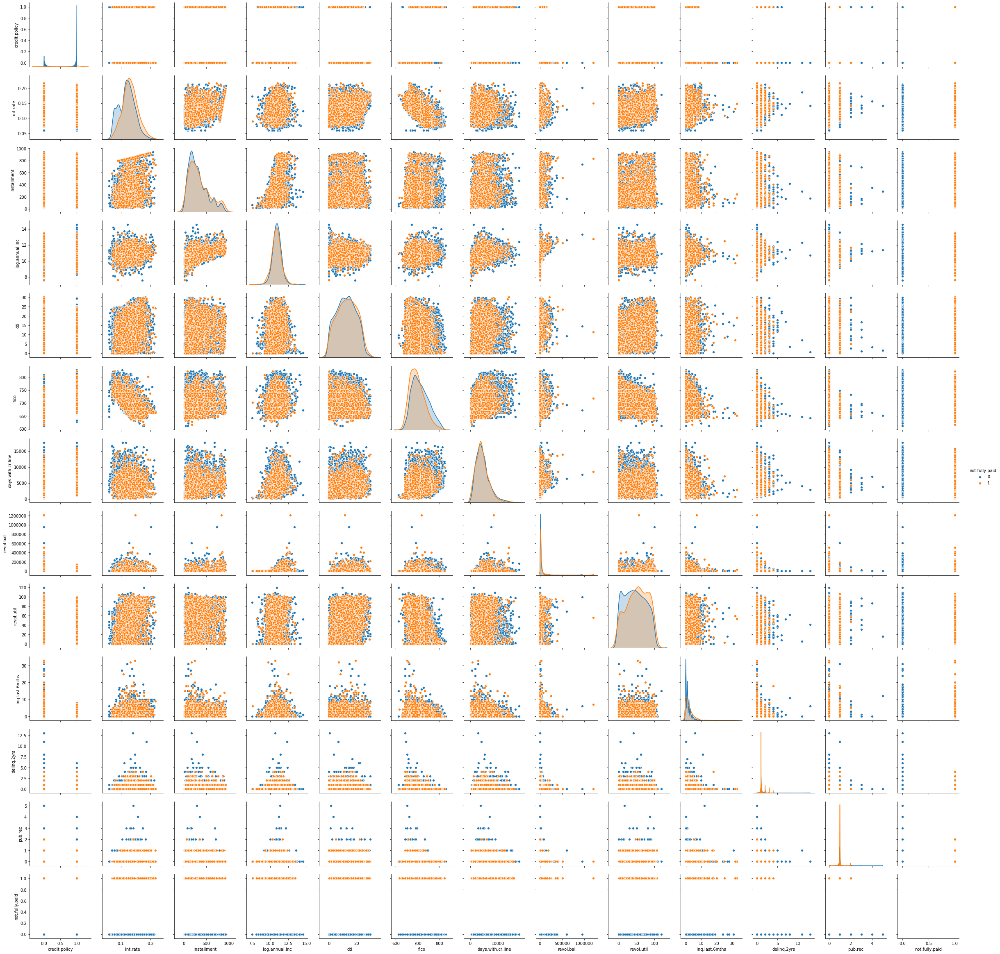

In [6]:
sns.pairplot(data=df , hue='not.fully.paid')

## TRAINING

In [7]:
def column_detail (dataFrame) :
    columns = []
    dtype = []
    null = []
    null_perc = []
    unique = []
    unique_sample = []
    for item in dataFrame:
        columns.append(item)
        dtype.append(str(dataFrame[item].dtype))
        null.append(dataFrame[item].isnull().sum())
        null_perc.append(dataFrame[item].isnull().sum() / 244 * 100)
        unique.append(dataFrame[item].nunique())
        unique_sample.append(list(dataFrame[item].unique()[:2]))
    return{"columns" : columns , 'dtype' : dtype , 'null_value' : null , 'null_perc' : null_perc , 'unique' : unique , 'unique_sample' : unique_sample}

In [8]:
data = column_detail(df)

In [9]:
df_column = pd.DataFrame(data)

In [10]:
df_column

,columns,dtype,null_value,null_perc,unique,unique_sample
0,credit.policy,int64,0,0.0,2,"[1, 0]"
1,purpose,object,0,0.0,7,"[debt_consolidation, credit_card]"
2,int.rate,float64,0,0.0,249,"[0.1189, 0.1071]"
3,installment,float64,0,0.0,4788,"[829.1, 228.22]"
4,log.annual.inc,float64,0,0.0,1987,"[11.35040654, 11.08214255]"
5,dti,float64,0,0.0,2529,"[19.48, 14.29]"
6,fico,int64,0,0.0,44,"[737, 707]"
7,days.with.cr.line,float64,0,0.0,2687,"[5639.958333, 2760.0]"
8,revol.bal,int64,0,0.0,7869,"[28854, 33623]"
9,revol.util,float64,0,0.0,1035,"[52.1, 76.7]"


In [11]:
df.shape

(9578, 14)

In [12]:
df = pd.get_dummies(df)

In [13]:
df.shape

(9578, 20)

In [14]:
x = df.drop('not.fully.paid' , axis=1)

In [15]:
x.shape

(9578, 19)

In [16]:
y = df['not.fully.paid']

In [17]:
y.shape

(9578,)

In [18]:
import sklearn

In [19]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, confusion_matrix

In [20]:
x_train,x_test,y_train,y_test = train_test_split(x,y ,test_size=0.3 , random_state = 101)

In [21]:
x_test.shape

(2874, 19)

In [22]:
y_test.shape

(2874,)

In [23]:
dtree = DecisionTreeClassifier()

In [24]:
dtree.fit(x_train,y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')

In [25]:
prediction = dtree.predict(x_test)

In [26]:
prediction.sum()

574

In [27]:
y_test.sum()

443

In [40]:
from IPython.display import Image  
from sklearn.externals.six import StringIO  
from sklearn.tree import export_graphviz
import pydot

/Users/mac/anaconda3/lib/python3.7/site-packages/sklearn/externals/six.py:31: DeprecationWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", DeprecationWarning)


In [44]:
loan_data = StringIO()  
export_graphviz(dtree, out_file=loan_data,feature_names=x_train.columns,filled=True,rounded=True, 
                class_names = ['Fully Paid','Not Fully Paid'], precision = 2, proportion = False)

graph = pydot.graph_from_dot_data(loan_data.getvalue())  
Image(graph[0].create_png()) 

## Evaluation

In [28]:
print(classification_report(prediction , y_test))

              precision    recall  f1-score   support

           0       0.81      0.86      0.83      2300
           1       0.26      0.20      0.22       574

    accuracy                           0.73      2874
   macro avg       0.53      0.53      0.53      2874
weighted avg       0.70      0.73      0.71      2874



In [29]:
conf_met = confusion_matrix(prediction,y_test)

In [30]:
def printConf (data):
    a = '         Predict 0 Predict 1 \nActual 0: '+ str(data[0][0]) + '      ' + str(data[0][1]) + '\nActual 1:  '+ str(data[1][0]) + '      ' + str(data[1][1])
    print(a)

In [31]:
printConf(conf_met)

         Predict 0 Predict 1 
Actual 0: 1971      329
Actual 1:  460      114


In [32]:
1966 / (1966 + 332) 

0.855526544821584

In [33]:
111 / (111 + 465)

0.19270833333333334

In [34]:
1966 / (1966 + 465)

0.8087206910736322

In [35]:
111 / (111 + 332)

0.2505643340857788

In [36]:
# from sklearn.ensemble import RandomForestClassifier,GradientBoostingClassifier

In [37]:
# def classificationModel(x,y) :
#     x_test,x_train, y_test , y_train = train_test_split(x,y ,test_size = 0.3)
#     tree = DecisionTreeClassifier().fit(x_train , y_train)
#     rand_for = RandomForestClassifier(n_estimators=100).fit(x_train,y_train)
#     g_boost = GradientBoostingClassifier().fit(x_train, y_train)    
    
#     predictTree = tree.predict(x_test)
#     predictRand = rand_for.predict(x_test)
#     predictGboost = g_boost.predict(x_test)
    
#     precision = []
#     recall = []
    

    

In [38]:
# classificationModel(x,y)

In [39]:
prediction

array([0, 1, 0, ..., 0, 0, 0])